## Base Line Model

### Dataset Preparation

In [ ]:
import os
import zipfile
import requests

def download_and_extract(url, output_zip, extract_dir):
    # Download file
    if not os.path.exists(output_zip):
        print(f"Downloading dataset to: {output_zip}")
        response = requests.get(url, stream=True)
        with open(output_zip, "wb") as file:
            for chunk in response.iter_content(chunk_size=1024):
                file.write(chunk)
        print("Download completed!")
    else:
        print("Dataset already exists, skipping download!")

    # Extract file
    if not os.path.exists(extract_dir):
        print(f"Extracting to: {extract_dir}")
        with zipfile.ZipFile(output_zip, "r") as zip_ref:
            zip_ref.extractall(extract_dir)
        print("Extraction completed!")
    else:
        print("Files already extracted, skipping extraction!")

# Download and extract the low-resolution (LR) image dataset
# http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_unknown_X2.zip
lr_url = "http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_bicubic_X2.zip"
lr_zip = "./DIV2K_train_LR_bicubic_X2.zip"
lr_dir = "./DIV2K_train_LR_bicubic_X2"

download_and_extract(lr_url, lr_zip, lr_dir)

Download completed!
Extracting to: ./DIV2K_train_LR_bicubic_X2
Extraction completed!


In [ ]:
# Install necessary dependencies
!git clone https://github.com/xinntao/Real-ESRGAN.git
!pip install -r Real-ESRGAN/requirements.txt

In [ ]:
# Download pretrained models for Real-ESRGAN
!wget https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth -P Real-ESRGAN/weights
!wget https://github.com/xinntao/Real-ESRGAN/releases/download/v0.2.2.4/RealESRGAN_x4plus_anime_6B.pth -P Real-ESRGAN/weights

In [ ]:
import os
import shutil

os.makedirs("Real-ESRGAN/inputs", exist_ok=True)

src_dir = "DIV2K_train_LR_bicubic_X2"
dst_dir = "Real-ESRGAN/inputs"

for file_name in os.listdir(src_dir):
    full_file_name = os.path.join(src_dir, file_name)
    if os.path.isfile(full_file_name):
        shutil.copy(full_file_name, dst_dir)

print("copy finished")


copy finished


In [ ]:
import torch

print("PyTorch version:", torch.__version__)
print("Is CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("CUDA version:", torch.version.cuda)
    print("Device Name:", torch.cuda.get_device_name(0))

PyTorch version: 2.5.1+cu121
Is CUDA available: True
CUDA version: 12.1
Device Name: NVIDIA A100-SXM4-40GB


In [ ]:
!pip install realesrgan


### Image Processing

In [ ]:
import os
import cv2
import glob
from tqdm import tqdm
from basicsr.archs.rrdbnet_arch import RRDBNet
from basicsr.utils.download_util import load_file_from_url
from realesrgan import RealESRGANer
from realesrgan.archs.srvgg_arch import SRVGGNetCompact

# Configure paths
input_folder = 'Real-ESRGAN/inputs'  # Folder containing input images
output_folder = 'Real-ESRGAN/results'  # Folder for saving output images
weights_folder = 'Real-ESRGAN/weights'  # Folder to store model weights

# Ensure output and weights folders exist
os.makedirs(output_folder, exist_ok=True)
os.makedirs(weights_folder, exist_ok=True)

# Configure model
model_name = 'RealESRGAN_x4plus'
model_urls = {
    'RealESRGAN_x4plus': 'https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth',
    'RealESRNet_x4plus': 'https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.1/RealESRNet_x4plus.pth',
    'RealESRGAN_x4plus_anime_6B': 'https://github.com/xinntao/Real-ESRGAN/releases/download/v0.2.2.4/RealESRGAN_x4plus_anime_6B.pth'
}

# Load the selected model
if model_name == 'RealESRGAN_x4plus':
    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)
    netscale = 4
elif model_name == 'RealESRNet_x4plus':
    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)
    netscale = 4
elif model_name == 'RealESRGAN_x4plus_anime_6B':
    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=6, num_grow_ch=32, scale=4)
    netscale = 4
else:
    raise ValueError(f"Unsupported model: {model_name}")

# Download weights if not already present
model_path = os.path.join(weights_folder, f'{model_name}.pth')
if not os.path.exists(model_path):
    print(f"Downloading weights for {model_name}...")
    load_file_from_url(model_urls[model_name], model_dir=weights_folder)

# Initialize the upsampler
upsampler = RealESRGANer(
    scale=netscale,
    model_path=model_path,
    model=model,
    tile=0,  # No tiling
    tile_pad=10,
    pre_pad=0,
    half=True  # Use FP16 inference
)

# Check the input folder
if os.path.isfile(input_folder):
    paths = [input_folder]
else:
    paths = sorted(glob.glob(os.path.join(input_folder, '*')))

# Inference and save results
for idx, path in enumerate(tqdm(paths, desc="Processing images", unit="image")):
    print(path)
    imgname, extension = os.path.splitext(os.path.basename(path))
    img = cv2.imread(path, cv2.IMREAD_UNCHANGED)

    if img is None:
        print(f"Skipping invalid image: {path}")
        continue

    img_mode = 'RGBA' if len(img.shape) == 3 and img.shape[2] == 4 else None

    try:
        output, _ = upsampler.enhance(img, outscale=4)
    except RuntimeError as error:
        print(f"Error processing {path}: {error}")
        continue

    # Save the output image
    extension = extension[1:] if img_mode != 'RGBA' else 'png'
    save_path = os.path.join(output_folder, f'{imgname}_output.{extension}')
    cv2.imwrite(save_path, output)

print(f"Results saved in '{output_folder}'")


/usr/local/lib/python3.10/dist-packages/realesrgan/utils.py:63: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  loadnet = torch.load(model_path, map_location=torch.device('cpu

Real-ESRGAN/inputs/00003.png


Processing images:  10%|█         | 1/10 [00:01<00:12,  1.35s/image]

Real-ESRGAN/inputs/00017_gray.png


Processing images:  30%|███       | 3/10 [00:01<00:03,  2.27image/s]

Real-ESRGAN/inputs/0014.jpg
Real-ESRGAN/inputs/0030.jpg


Processing images:  50%|█████     | 5/10 [00:01<00:01,  4.06image/s]

Real-ESRGAN/inputs/ADE_val_00000114.jpg
Real-ESRGAN/inputs/OST_009.png


Processing images:  60%|██████    | 6/10 [00:02<00:01,  2.70image/s]

Real-ESRGAN/inputs/children-alpha.png


Processing images:  70%|███████   | 7/10 [00:03<00:01,  1.99image/s]

Real-ESRGAN/inputs/tree_alpha_16bit.png
	Input is a 16-bit image


Processing images: 100%|██████████| 10/10 [00:03<00:00,  2.54image/s]

Real-ESRGAN/inputs/video
Skipping invalid image: Real-ESRGAN/inputs/video
Real-ESRGAN/inputs/wolf_gray.jpg
Results saved in 'Real-ESRGAN/results'


### Base Line Results

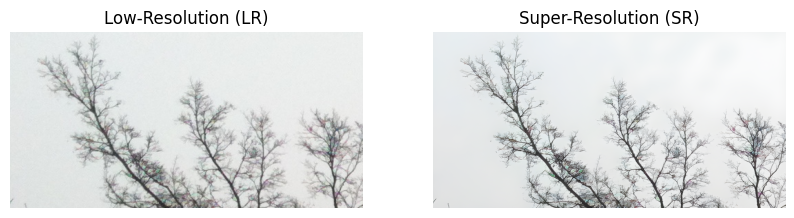

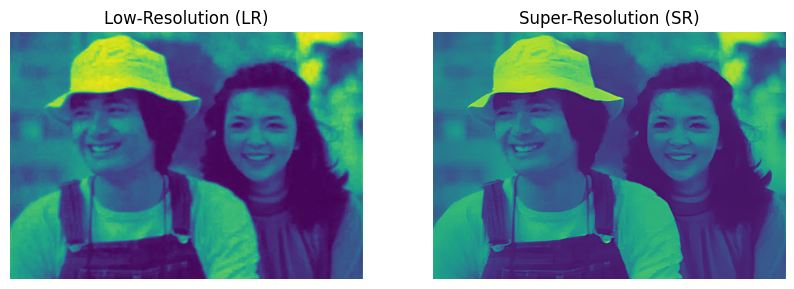

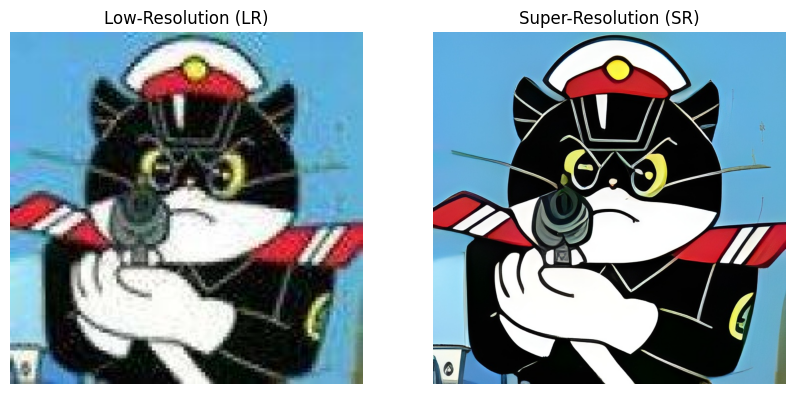

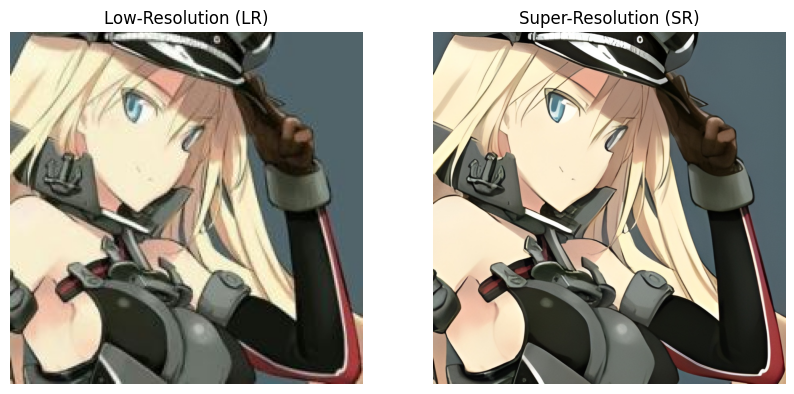

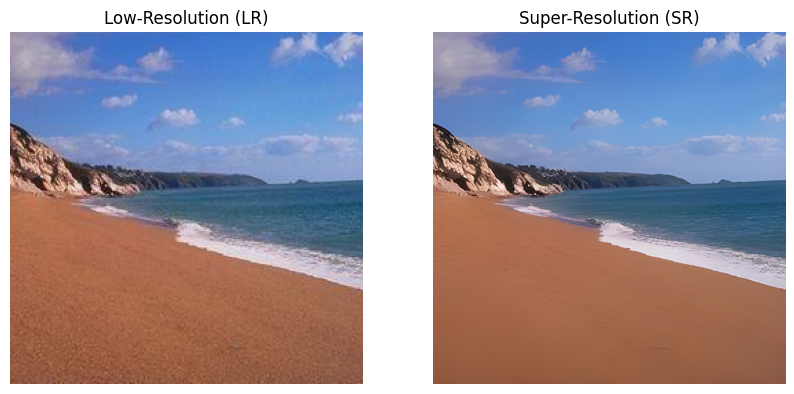

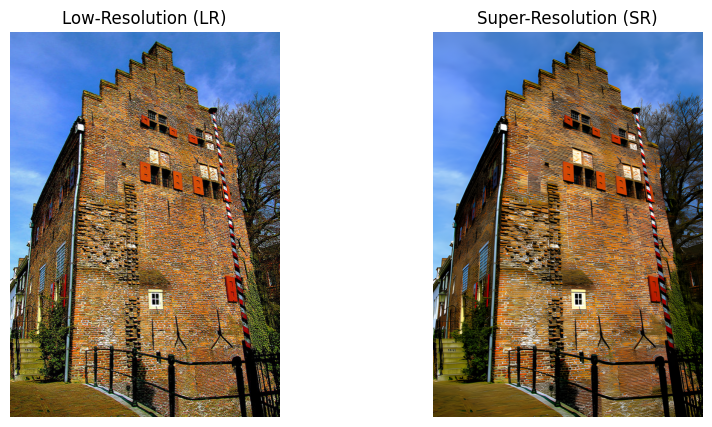

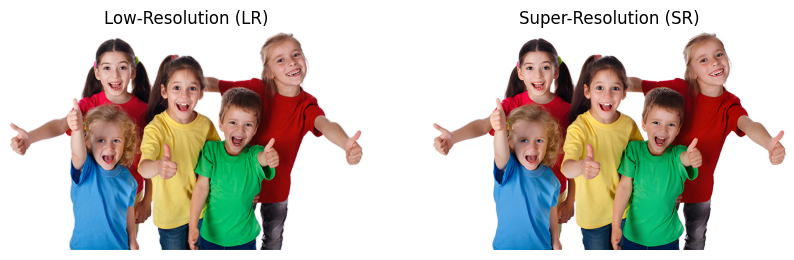

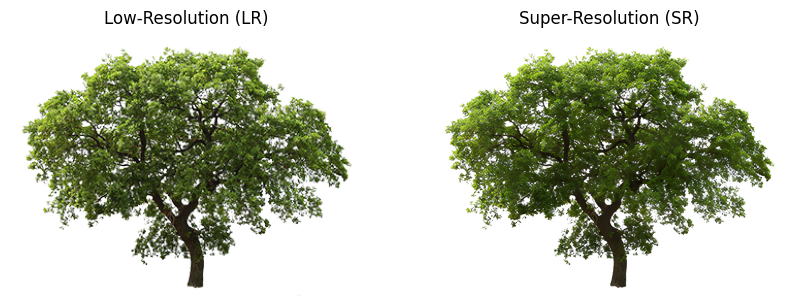

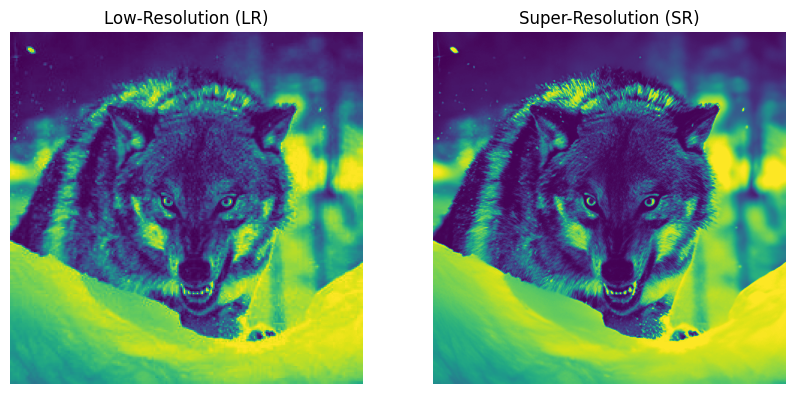

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

input_dir = './Real-ESRGAN/inputs'
result_dir = './Real-ESRGAN/results'

input_images = [f for f in sorted(os.listdir(input_dir)) if os.path.isfile(os.path.join(input_dir, f))]
result_images = [f for f in sorted(os.listdir(result_dir)) if os.path.isfile(os.path.join(result_dir, f))]


for inp, res in zip(input_images, result_images):
    input_image = Image.open(os.path.join(input_dir, inp))
    result_image = Image.open(os.path.join(result_dir, res))

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Low-Resolution (LR)")
    plt.imshow(input_image)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title("Super-Resolution (SR)")
    plt.imshow(result_image)
    plt.axis('off')

    plt.show()

## LoRA Fine Tuning

In [1]:
import os
import zipfile
import gdown
from google.colab import drive

# Step 1: Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:


# Define paths
drive_dir = "/content/drive/MyDrive"  # Path in Google Drive
extract_dir = os.path.join(drive_dir, "training")


# CelebA-HQ Google Drive link (direct download link with ID)
# dataset_url = "https://drive.google.com/uc?id=1badu11NqxGf6qM3PTTooQDJvQbejgbTv"

# Download and extract

In [ ]:
import torch
torch.cuda.empty_cache()


In [3]:
!git clone https://github.com/xinntao/ESRGAN.git


Cloning into 'ESRGAN'...
remote: Enumerating objects: 225, done.
remote: Counting objects: 100% (225/225), done.
remote: Compressing objects: 100% (131/131), done.
remote: Total 225 (delta 86), reused 219 (delta 84), pack-reused 0 (from 0)
Receiving objects: 100% (225/225), 24.86 MiB | 15.28 MiB/s, done.
Resolving deltas: 100% (86/86), done.


In [4]:
import functools
import torch
import torch.nn as nn
import torch.nn.functional as F
from ESRGAN.RRDBNet_arch import RRDBNet
class RRDBNet_8x(RRDBNet):
    def __init__(self, in_nc, out_nc, nf, nb, gc=32):
        super().__init__(in_nc, out_nc, nf, nb, gc)
        self.upconv3 = nn.Conv2d(nf, nf, 3, 1, 1, bias=True)

    def forward(self, x):
        fea = self.conv_first(x)
        trunk = self.trunk_conv(self.RRDB_trunk(fea))
        fea = fea + trunk

        # 8x upscaling with three upsampling steps
        fea = self.lrelu(self.upconv1(F.interpolate(fea, scale_factor=2, mode='nearest')))
        fea = self.lrelu(self.upconv2(F.interpolate(fea, scale_factor=2, mode='nearest')))
        fea = self.lrelu(self.upconv3(F.interpolate(fea, scale_factor=2, mode='nearest')))
        out = self.conv_last(self.lrelu(self.HRconv(fea)))
        return out


### Defining Perceptual Loss

In [5]:
from torchvision.models import vgg16
# Define Perceptual Loss
class PerceptualLoss(nn.Module):
    def __init__(self):
        super(PerceptualLoss, self).__init__()
        vgg = vgg16(pretrained=True).features[:16].eval()
        for param in vgg.parameters():
            param.requires_grad = False
        self.vgg = vgg
        self.mse_loss = nn.MSELoss()

    def forward(self, x, y):
        x_features = self.vgg(x)
        y_features = self.vgg(y)
        return self.mse_loss(x_features, y_features)

### Simplified Model Training

In [18]:
import os
import cv2
import glob
import requests
from tqdm import tqdm
from peft import LoraConfig, get_peft_model
import torch.quantization
from basicsr.archs.rrdbnet_arch import RRDBNet
from realesrgan import RealESRGANer
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToTensor, Resize
import torch
from PIL import Image
import zipfile
import gdown
from torch.optim.lr_scheduler import StepLR

# Define Dataset Class
class CelebA_HQ_Dataset(Dataset):
    def __init__(self, root_dir, hr_size=1024, lr_size=256):
        self.img_paths = sorted(glob.glob(os.path.join(root_dir, "*.jpg")))
        if len(self.img_paths) == 0:
            raise ValueError(f"No images found in directory: {root_dir}")

        self.hr_transform = Resize((hr_size, hr_size), Image.BICUBIC)
        self.lr_transform = Resize((lr_size, lr_size), Image.BICUBIC)
        self.to_tensor = ToTensor()

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img = Image.open(self.img_paths[idx]).convert("RGB")
        hr_img = self.hr_transform(img)
        lr_img = self.lr_transform(hr_img)
        return self.to_tensor(lr_img), self.to_tensor(hr_img)


# Initialize Dataset and DataLoader
dataset = CelebA_HQ_Dataset(extract_dir, hr_size=1024, lr_size=256)
dataloader = DataLoader(dataset, batch_size=2, shuffle=True, num_workers=4)

# Initialize Model
model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)


# Load Pretrained Weights
weights_path = "/content/Real-ESRGAN/weights/RealESRGAN_x4plus.pth"
pretrained_weights = torch.load(weights_path)
model_dict = model.state_dict()
pretrained_weights = {k: v for k, v in pretrained_weights.items() if k in model_dict}
model_dict.update(pretrained_weights)
model.load_state_dict(model_dict, strict=False)
print("Loaded pretrained weights.")

# Apply LoRA
config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=["conv_up1", "conv_up2", "conv_hr"],  # Apply LoRA to these layers
    lora_dropout=0.1,
    task_type="SUPER_RESOLUTION"
)

model = get_peft_model(model, config)  # Wrap the model with LoRA
print("LoRA configuration applied.")

# Move model to device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)

# Loss Functions
mse_loss = nn.MSELoss()
perceptual_loss = PerceptualLoss().to(device)

# Optimizer and Scheduler
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)  # Reduce LR every 5 epochs

# Training Loop
epochs = 1
for epoch in range(epochs):
    model.train()
    epoch_loss = 0
    for lr_imgs, hr_imgs in tqdm(dataloader, desc=f"Epoch {epoch+1}/{epochs}"):
        lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

        optimizer.zero_grad()
        output_imgs = model(lr_imgs)

        # Combine MSE and Perceptual Loss
        loss = mse_loss(output_imgs, hr_imgs) + 0.01 * perceptual_loss(output_imgs, hr_imgs)
        loss.backward()

        # Gradient clipping for stability
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

        optimizer.step()
        epoch_loss += loss.item()

    scheduler.step()
    print(f"Epoch [{epoch+1}/{epochs}] Loss: {epoch_loss / len(dataloader):.4f}")

# Save Fine-Tuned LoRA Model
os.makedirs("output", exist_ok=True)
torch.save(model.state_dict(), "output/RRDBNet_8x_lora_finetuned.pth")
print("LoRA fine-tuned model saved.")




<ipython-input-18-cad370f00363>:49: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  pretrained_weights = torch.load(weights_path)


Loaded pretrained weights.
LoRA configuration applied.


Epoch 1/1: 100%|██████████| 5001/5001 [25:34<00:00,  3.26it/s]


Epoch [1/1] Loss: 0.0090
LoRA fine-tuned model saved.


In [ ]:
import torch
from basicsr.archs.rrdbnet_arch import RRDBNet

# Path to the pretrained model
pretrained_model_path = "/content/Real-ESRGAN/weights/RealESRGAN_x4plus.pth"

# Load the RRDBNet model
model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)
state_dict = torch.load(pretrained_model_path, map_location="cpu")

# Update the model with pretrained weights (optional)
model.load_state_dict(state_dict, strict=False)

# Print the model structure
print("Model Structure:")
print(model)

# Print layer names (key names of the state_dict)
print("\nLayer Names in the Pretrained Model:")
for key in state_dict.keys():
    print(key)


### Comprehensive Model training

In [55]:
import os
import glob
import random
from tqdm import tqdm
import torch
import torch.nn as nn
from torch.optim.lr_scheduler import StepLR
from torchvision.transforms import ToTensor, Resize
from torch.utils.data import DataLoader, Dataset, Subset
from basicsr.archs.rrdbnet_arch import RRDBNet
from peft import LoraConfig, get_peft_model
from torchvision.models import vgg19
from PIL import Image

# Define Perceptual Loss using VGG19
class PerceptualLoss(nn.Module):
    def __init__(self, vgg_layers):
        super(PerceptualLoss, self).__init__()
        self.vgg = vgg19(pretrained=True).features[:vgg_layers].eval()
        for param in self.vgg.parameters():
            param.requires_grad = False

    def forward(self, x, y):
        return torch.nn.functional.mse_loss(self.vgg(x), self.vgg(y))

# Dataset Class
class CelebA_HQ_Dataset(Dataset):
    def __init__(self, root_dir, hr_size=1024, lr_size=256):
        self.img_paths = sorted(glob.glob(os.path.join(root_dir, "*.jpg")))
        if len(self.img_paths) == 0:
            raise ValueError(f"No images found in directory: {root_dir}")
        self.hr_transform = Resize((hr_size, hr_size), Image.BICUBIC)
        self.lr_transform = Resize((lr_size, lr_size), Image.BICUBIC)
        self.to_tensor = ToTensor()

    def __len__(self):
        return len(self.img_paths)

    def __getitem__(self, idx):
        img = Image.open(self.img_paths[idx]).convert("RGB")
        hr_img = self.hr_transform(img)
        lr_img = self.lr_transform(hr_img)
        return self.to_tensor(lr_img), self.to_tensor(hr_img)

# Early Stopping
class EarlyStopping:
    def __init__(self, patience=5, delta=0.01):
        self.patience = patience
        self.delta = delta
        self.best_loss = float('inf')
        self.counter = 0

    def __call__(self, loss):
        if loss < self.best_loss - self.delta:
            self.best_loss = loss
            self.counter = 0
        else:
            self.counter += 1
        return self.counter >= self.patience

# Paths
data_dir = "/content/drive/MyDrive/training"
output_dir = "output"
os.makedirs(output_dir, exist_ok=True)

# Initialize Dataset and Random Sampler
full_dataset = CelebA_HQ_Dataset(data_dir, hr_size=1024, lr_size=256)
batch_size = 2
num_images_per_epoch = 1000
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Initialize Model
model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)

# Load Pretrained Weights
weights_path = "/content/Real-ESRGAN/weights/RealESRGAN_x4plus.pth"
pretrained_weights = torch.load(weights_path)
model.load_state_dict(pretrained_weights, strict=False)

# Apply LoRA
config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=[
        "conv_up1", "conv_up2", "conv_hr", "conv_body",  # Top-level layers
        "body.*.rdb1.conv1", "body.*.rdb1.conv2", "body.*.rdb1.conv3", "body.*.rdb1.conv4", "body.*.rdb1.conv5",  # RRDB-rdb1
        "body.*.rdb2.conv1", "body.*.rdb2.conv2", "body.*.rdb2.conv3", "body.*.rdb2.conv4", "body.*.rdb2.conv5",  # RRDB-rdb2
        "body.*.rdb3.conv1", "body.*.rdb3.conv2", "body.*.rdb3.conv3", "body.*.rdb3.conv4", "body.*.rdb3.conv5"   # RRDB-rdb3
    ],
    lora_dropout=0,
    task_type="SUPER_RESOLUTION"
)
model = get_peft_model(model, config).to(device)

# Losses
mse_loss = nn.L1Loss()  # Content Loss
perceptual_loss = PerceptualLoss(vgg_layers=16).to(device)
adv_loss = nn.BCEWithLogitsLoss()  # GAN Loss

# Discriminator for Adversarial Loss
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.net = nn.Sequential(
            nn.Conv2d(3, 64, 4, stride=2, padding=1),  # Output: 64 x H/2 x W/2
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, stride=2, padding=1),  # Output: 128 x H/4 x W/4
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, stride=2, padding=1),  # Output: 256 x H/8 x W/8
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, 4, stride=2, padding=1),  # Output: 512 x H/16 x W/16
            nn.LeakyReLU(0.2, inplace=True),
            nn.AdaptiveAvgPool2d(1),  # Global average pooling to 1x1
            nn.Flatten(),
            nn.Linear(512, 1)  # Output: single scalar for real/fake
        )

    def forward(self, x):
        return self.net(x)


discriminator = Discriminator().to(device)
optimizer_G = torch.optim.Adam(model.parameters(), lr=1e-4)
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=1e-4)
scheduler = StepLR(optimizer_G, step_size=5, gamma=0.5)
early_stopping = EarlyStopping(patience=5)

# Training Loop
epochs = 50
for epoch in range(epochs):
    model.train()
    discriminator.train()

    # Randomly sample 1000 images
    indices = random.sample(range(len(full_dataset)), num_images_per_epoch)
    sampler = Subset(full_dataset, indices)
    dataloader = DataLoader(sampler, batch_size=batch_size, shuffle=True)

    epoch_loss = 0
    for lr_imgs, hr_imgs in tqdm(dataloader, desc=f"Epoch {epoch+1}/{epochs}"):
        lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

        # Generate SR Images
        sr_imgs = model(lr_imgs)

        # Train Discriminator
        optimizer_D.zero_grad()
        real_loss = adv_loss(discriminator(hr_imgs), torch.ones_like(discriminator(hr_imgs)))
        fake_loss = adv_loss(discriminator(sr_imgs.detach()), torch.zeros_like(discriminator(sr_imgs)))
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()

        # Train Generator
        optimizer_G.zero_grad()
        content = mse_loss(sr_imgs, hr_imgs)
        perceptual = perceptual_loss(sr_imgs, hr_imgs)
        adversarial = adv_loss(discriminator(sr_imgs), torch.ones_like(discriminator(sr_imgs)))
        g_loss = content + 0.01 * perceptual + 0.005 * adversarial
        g_loss.backward()
        optimizer_G.step()

        epoch_loss += g_loss.item()

    scheduler.step()
    epoch_loss /= len(dataloader)
    print(f"Epoch [{epoch+1}/{epochs}] Loss: {epoch_loss:.4f}")

    # Early Stopping
    if early_stopping(epoch_loss):
        print("Early stopping triggered.")
        break

# Save Fine-Tuned Model
torch.save(model.state_dict(), os.path.join(output_dir, "RRDBNet_8x_lora_finetuned.pth"))
print("Model training complete and saved.")


<ipython-input-55-e233b58a94fc>:77: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  pretrained_weights = torch.load(weights_path)
Epoch 1/50: 100%|██████████| 500/500 [04:31<0

Epoch [1/50] Loss: 0.0572


Epoch 2/50: 100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Epoch [2/50] Loss: 0.0392


Epoch 3/50: 100%|██████████| 500/500 [02:58<00:00,  2.79it/s]


Epoch [3/50] Loss: 0.0361


Epoch 4/50: 100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Epoch [4/50] Loss: 0.0358


Epoch 5/50: 100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Epoch [5/50] Loss: 0.0376


Epoch 6/50: 100%|██████████| 500/500 [02:58<00:00,  2.80it/s]


Epoch [6/50] Loss: 0.0382


Epoch 7/50: 100%|██████████| 500/500 [02:59<00:00,  2.79it/s]

Epoch [7/50] Loss: 0.0399
Early stopping triggered.
Model training complete and saved.


### Simplified Model Performance

<ipython-input-49-dae06a5d44b0>:27: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Loaded LoRA fine-tuned model successfully.
Randomly selected images: ['24172.jpg', '24077.jpg', '24144.jpg', '24185.jpg', '24203.jpg', '24202.jpg', '24175.jpg', '24123.jpg', '24135.jpg', '24078.jpg']
Processing: /content/drive/MyDrive/testing/24172.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


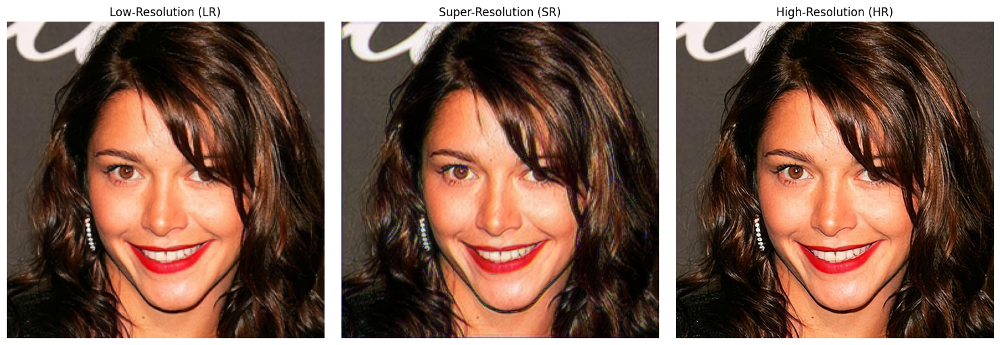

Processing: /content/drive/MyDrive/testing/24077.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


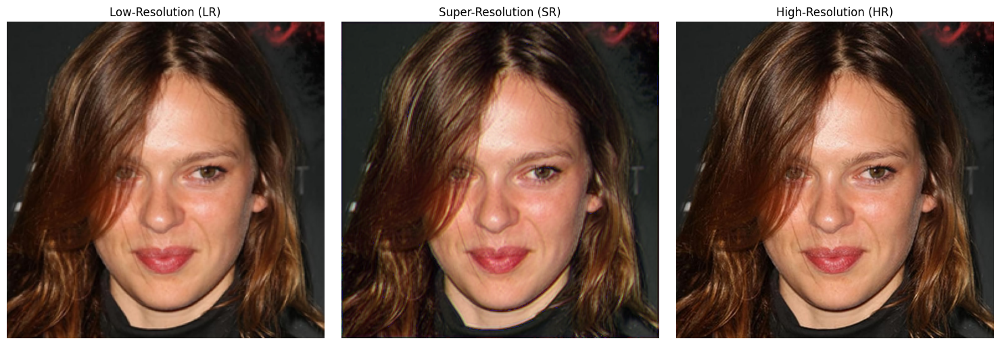

Processing: /content/drive/MyDrive/testing/24144.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


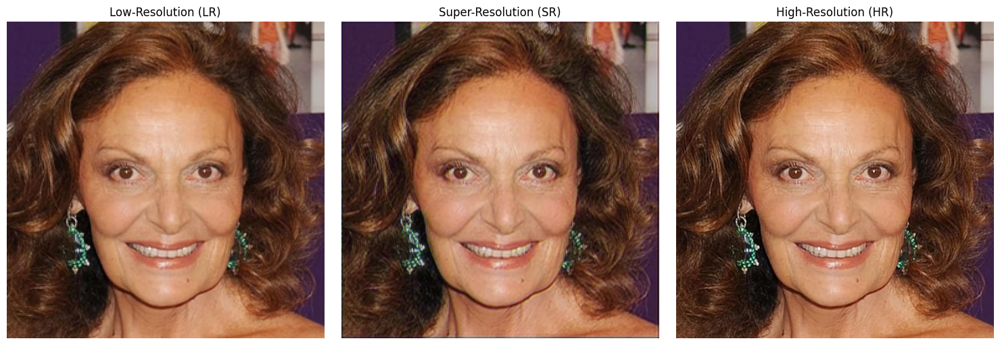

Processing: /content/drive/MyDrive/testing/24185.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


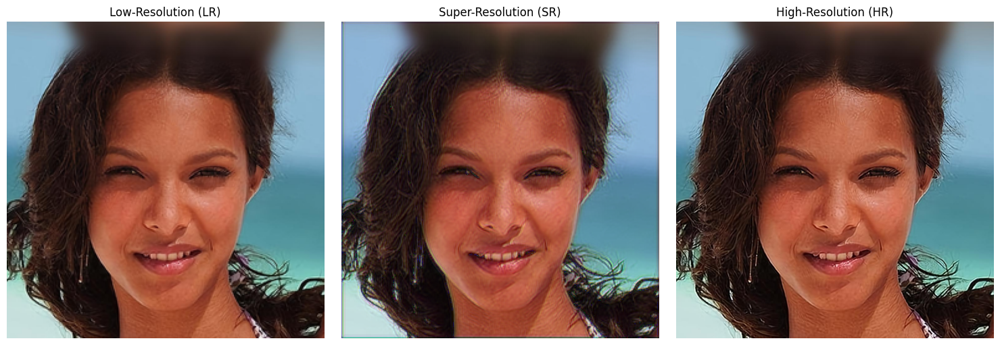

Processing: /content/drive/MyDrive/testing/24203.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


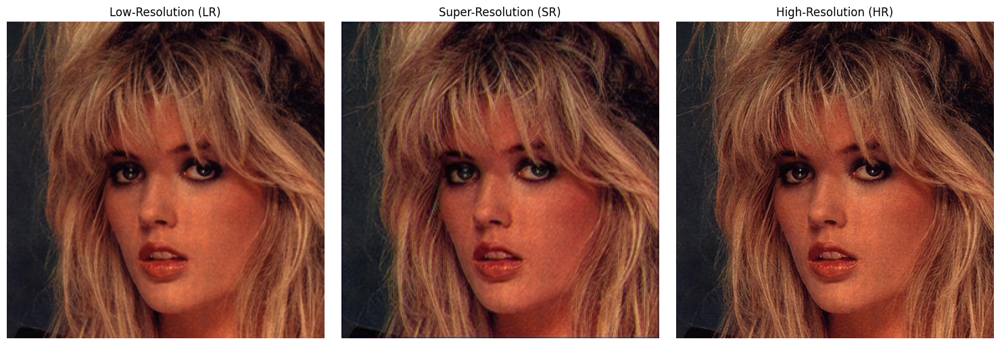

Processing: /content/drive/MyDrive/testing/24202.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


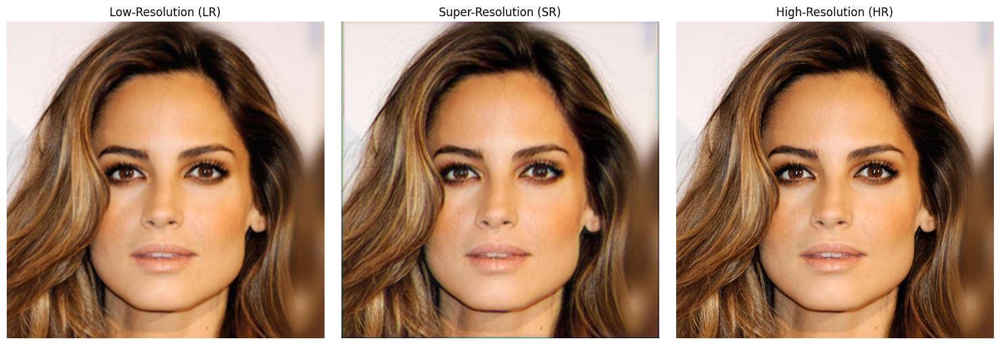

Processing: /content/drive/MyDrive/testing/24175.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


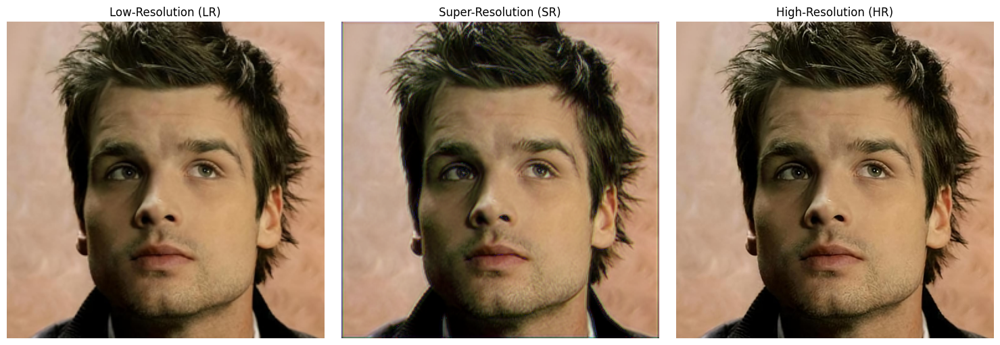

Processing: /content/drive/MyDrive/testing/24123.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


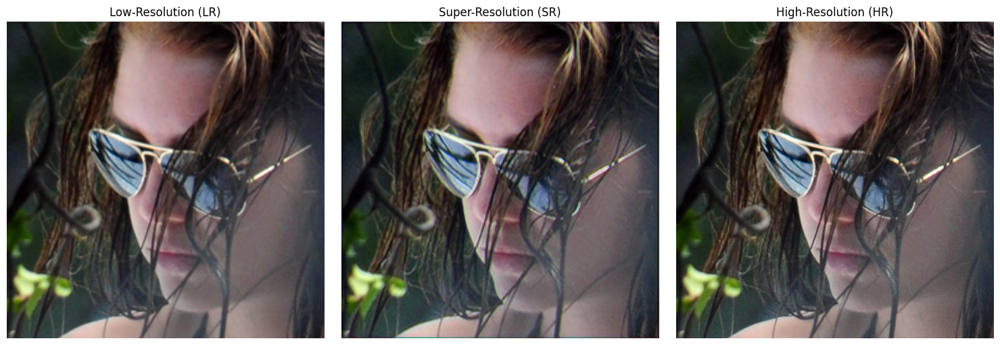

Processing: /content/drive/MyDrive/testing/24135.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


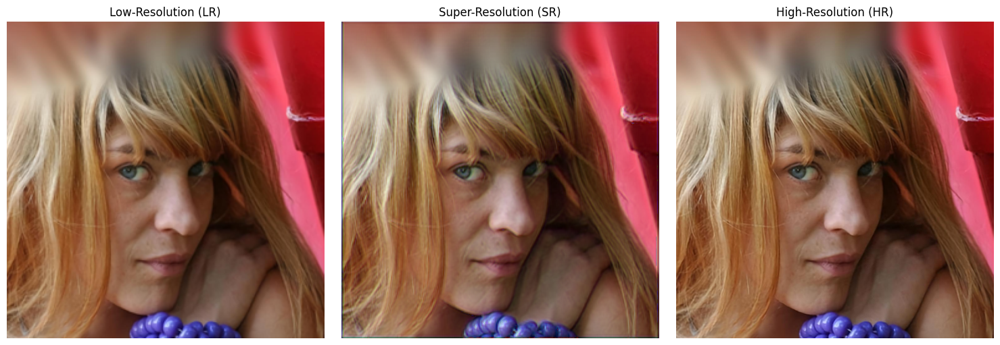

Processing: /content/drive/MyDrive/testing/24078.jpg
Input LR Shape: torch.Size([1, 3, 256, 256])
Output SR Shape: torch.Size([1, 3, 1024, 1024])


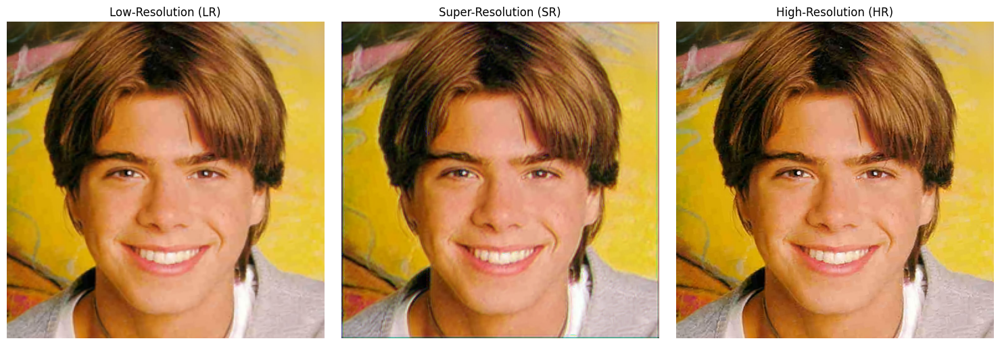

Super-resolution results saved to '/content/drive/MyDrive/testing_results'.


In [49]:
import os
import torch
import glob
from PIL import Image
from torchvision.transforms import ToTensor, ToPILImage, Resize
from basicsr.archs.rrdbnet_arch import RRDBNet
from peft import LoraConfig, get_peft_model

# Paths
model_path = "/content/drive/MyDrive/outputs/lora_finetuned_5epoch.pth"  # Path to LoRA fine-tuned model
input_folder = "/content/drive/MyDrive/testing"      # Folder containing test images
output_folder = "/content/drive/MyDrive/testing_results"
os.makedirs(output_folder, exist_ok=True)

# Load the RRDBNet Model and LoRA Configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)

config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=["conv_up1", "conv_up2", "conv_hr"],
    lora_dropout=0,
    task_type="SUPER_RESOLUTION"
)
model = get_peft_model(model, config)
model.load_state_dict(torch.load(model_path, map_location=device))
model.to(device)
model.eval()
print("Loaded LoRA fine-tuned model successfully.")

# Preprocessing
to_tensor = ToTensor()
to_pil = ToPILImage()

def process_image(image, scale=4):
    """Downsample an image and generate super-resolution."""
    # Simulate Low-Resolution (LR) image
    lr_image = Resize((image.height // scale, image.width // scale), Image.BICUBIC)(image)
    lr_tensor = to_tensor(lr_image).unsqueeze(0).to(device)  # LR Tensor

    # Generate Super-Resolution (SR) image
    with torch.no_grad():
        sr_tensor = model(lr_tensor)  # Pass LR tensor through model
        sr_tensor = torch.clamp(sr_tensor, 0, 1)  # Clamp values to [0, 1]

    # Check SR tensor shape
    print("Input LR Shape:", lr_tensor.shape)
    print("Output SR Shape:", sr_tensor.shape)

    # Upsample SR output to desired HR size explicitly (optional if model skips this)
    sr_tensor = torch.nn.functional.interpolate(sr_tensor, scale_factor=scale, mode="bicubic", align_corners=False)
    sr_image = to_pil(sr_tensor.squeeze(0).cpu())

    return lr_image, sr_image

# Randomly Select 10 Images
all_images = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png'))]
random_images = random.sample(all_images, 10)
print(f"Randomly selected images: {random_images}")

# Side-by-Side Comparison
for idx, img_name in enumerate(random_images):
    img_path = os.path.join(input_folder, img_name)
    print(f"Processing: {img_path}")

    hr_image = Image.open(img_path).convert("RGB")  # High-Resolution Image
    lr_image, sr_image = process_image(hr_image, scale=4)  # LR and SR Images

    # Save SR Image
    sr_save_path = os.path.join(output_folder, f"{os.path.splitext(img_name)[0]}_SR.png")
    sr_image.save(sr_save_path)

    # Display Side-by-Side Comparison
    plt.figure(figsize=(15, 5))

    # Low-Resolution Image
    plt.subplot(1, 3, 1)
    plt.title("Low-Resolution (LR)")
    plt.imshow(lr_image)
    plt.axis("off")

    # Super-Resolution Image
    plt.subplot(1, 3, 2)
    plt.title("Super-Resolution (SR)")
    plt.imshow(sr_image)
    plt.axis("off")

    # High-Resolution Image
    plt.subplot(1, 3, 3)
    plt.title("High-Resolution (HR)")
    plt.imshow(hr_image)
    plt.axis("off")

    plt.tight_layout()
    plt.show()

print(f"Super-resolution results saved to '{output_folder}'.")


### Simplified Model with Progressive Reconstruction with Tiling (2048*2048 resolution)

<ipython-input-73-3ca1450ebb90>:28: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Loaded LoRA fine-tuned model successfully.
Randomly selected images: ['24111.jpg', '24126.jpg', '24191.jpg', '24172.jpg', '24088.jpg', '24087.jpg', '24192.jpg', '24101.jpg', '24119.jpg', '24176.jpg']
Processing: /content/drive/MyDrive/testing/24111.jpg


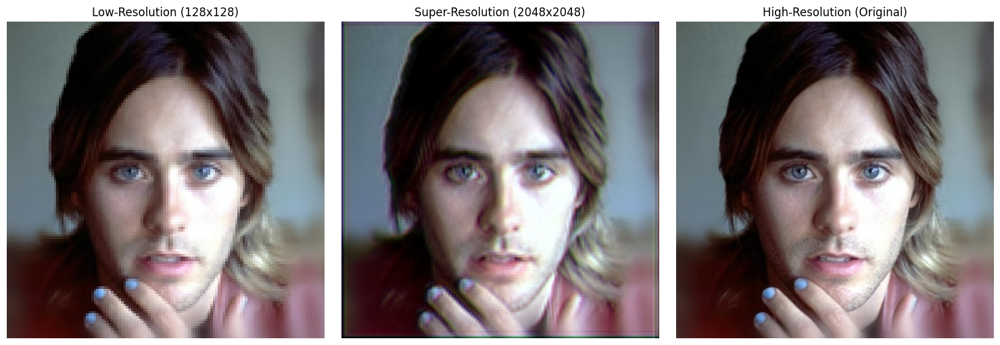

Processing: /content/drive/MyDrive/testing/24126.jpg


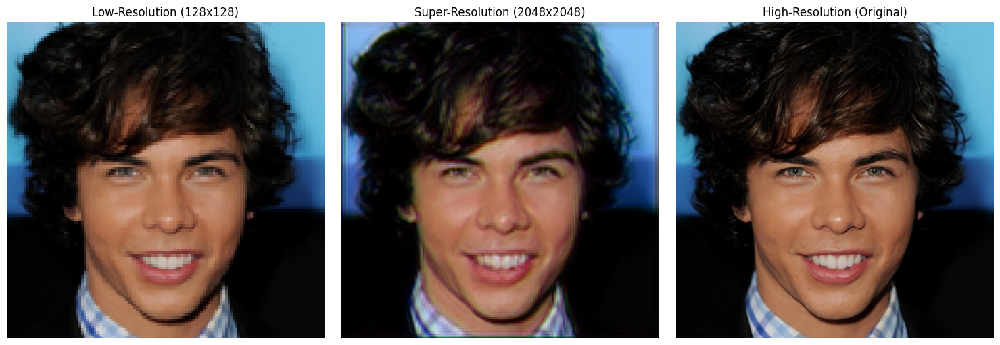

Processing: /content/drive/MyDrive/testing/24191.jpg


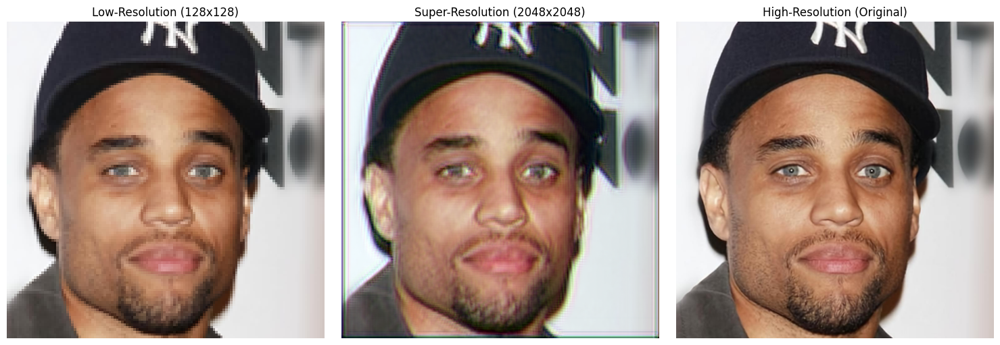

Processing: /content/drive/MyDrive/testing/24172.jpg


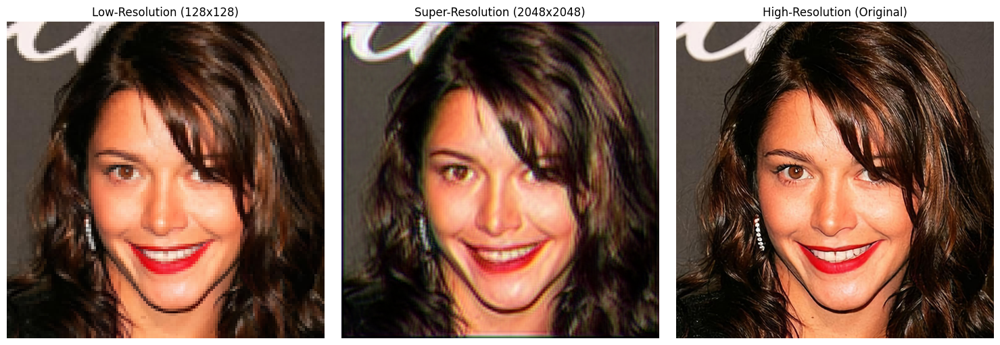

Processing: /content/drive/MyDrive/testing/24088.jpg


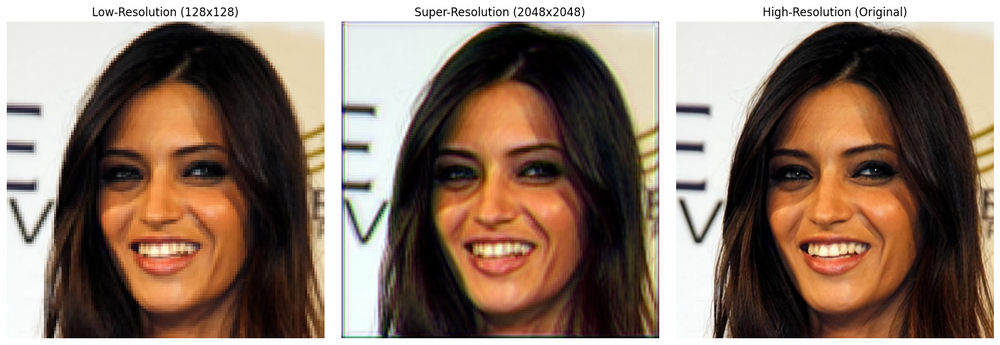

Processing: /content/drive/MyDrive/testing/24087.jpg


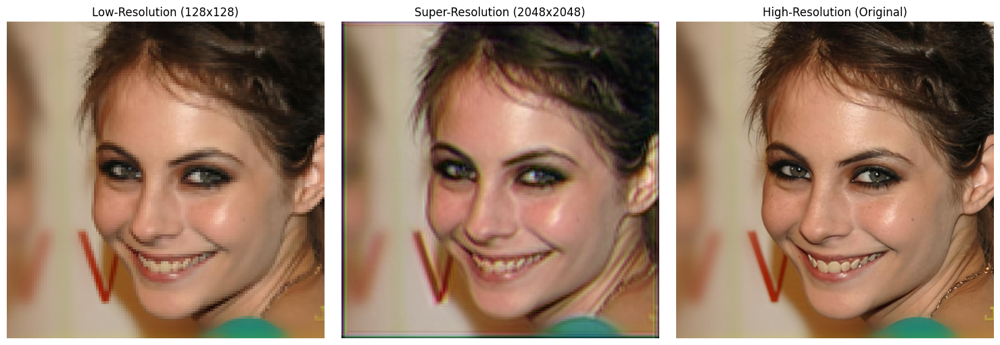

Processing: /content/drive/MyDrive/testing/24192.jpg


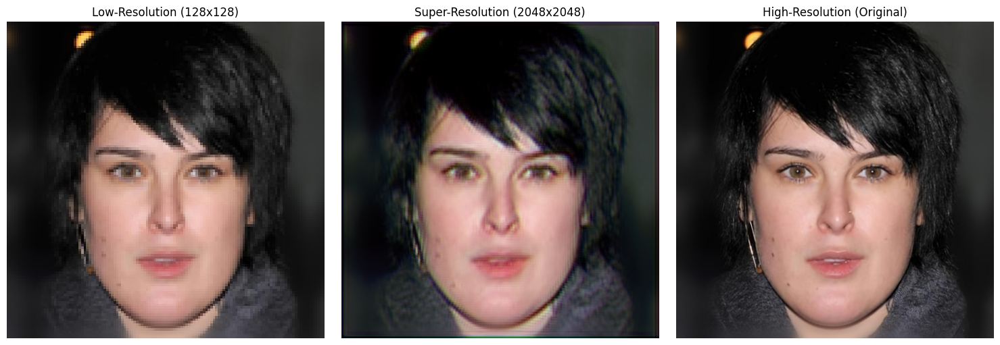

Processing: /content/drive/MyDrive/testing/24101.jpg


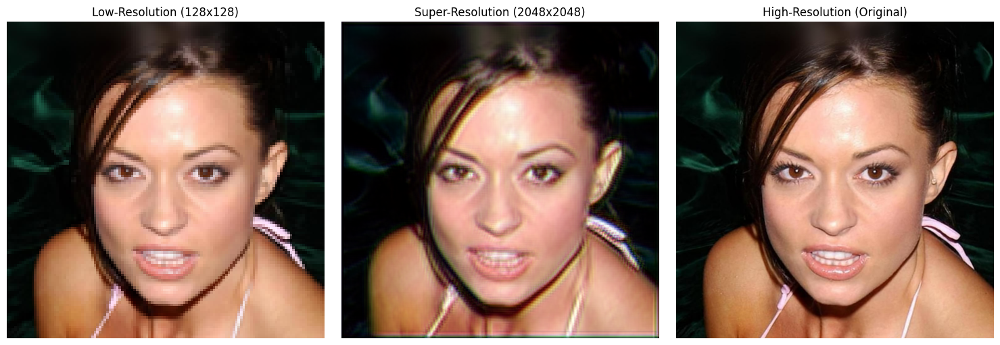

Processing: /content/drive/MyDrive/testing/24119.jpg


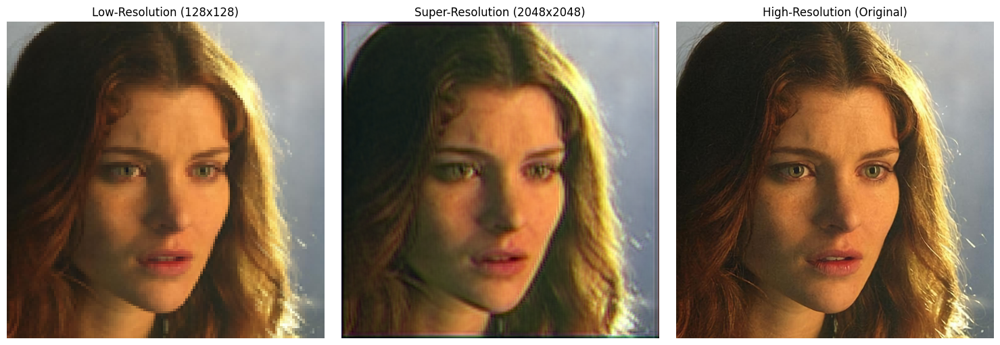

Processing: /content/drive/MyDrive/testing/24176.jpg


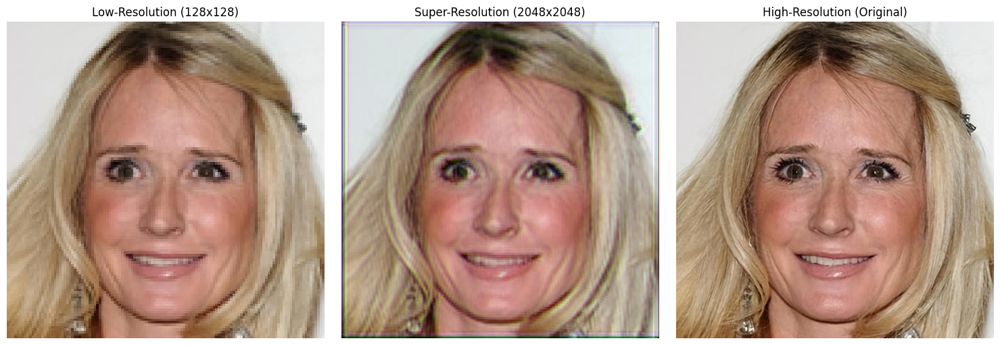

Progressive super-resolution results saved to '/content/drive/MyDrive/testing_results'.


In [73]:
import os
import random
import torch
import matplotlib.pyplot as plt
from PIL import Image
from torchvision.transforms import ToTensor, ToPILImage, Resize
from basicsr.archs.rrdbnet_arch import RRDBNet
from peft import LoraConfig, get_peft_model

# Paths
model_path = "/content/drive/MyDrive/outputs/lora_finetuned_5epoch.pth"  # Path to LoRA fine-tuned model
input_folder = "/content/drive/MyDrive/testing"      # Folder containing test images
output_folder = "/content/drive/MyDrive/testing_results"
os.makedirs(output_folder, exist_ok=True)

# Load the RRDBNet Model and LoRA Configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4)

config = LoraConfig(
    r=16,
    lora_alpha=32,
    target_modules=["conv_up1", "conv_up2", "conv_hr"],
    lora_dropout=0,
    task_type="SUPER_RESOLUTION"
)
model = get_peft_model(model, config)
model.load_state_dict(torch.load(model_path, map_location=device))
model.to(device)
model.eval()
print("Loaded LoRA fine-tuned model successfully.")

# Preprocessing
to_tensor = ToTensor()
to_pil = ToPILImage()

import torch.nn.functional as F

def progressive_sr(image, steps=[4, 4], tile_size=256, tile_overlap=32):
    """
    Perform progressive super-resolution with tiling to handle large-scale outputs.

    Args:
        image: Input PIL image.
        steps: List of scale factors for progressive upscaling.
        tile_size: Size of each tile for processing.
        tile_overlap: Overlap between tiles to reduce edge artifacts.

    Returns:
        sr_image: Final super-resolved image.
    """
    current_image = image  # Start with the input image

    for scale in steps:
        # Apply tile-based super-resolution for each scale step
        current_image = tile_based_sr(current_image, scale=scale, tile_size=tile_size, tile_overlap=tile_overlap)

    return current_image


def tile_based_sr(image, scale=4, tile_size=256, tile_overlap=32):
    """
    Perform tile-based super-resolution with smooth blending to remove boundary artifacts.

    Args:
        image: Input PIL image.
        scale: Scale factor (e.g., 4).
        tile_size: Size of each tile to process individually.
        tile_overlap: Overlap size between tiles to avoid edge artifacts.

    Returns:
        sr_image: Final super-resolved image.
    """
    # Convert image to tensor
    lr_tensor = to_tensor(image).unsqueeze(0).to(device)  # Shape: [1, 3, H, W]
    _, _, lr_h, lr_w = lr_tensor.shape

    # Compute SR tensor shape
    sr_h, sr_w = lr_h * scale, lr_w * scale
    sr_tensor = torch.zeros((1, 3, sr_h, sr_w), device=device)  # Output placeholder
    count_map = torch.zeros((1, 1, sr_h, sr_w), device=device)  # For blending overlaps

    # Create a smooth blending mask (at SR resolution)
    mask = torch.ones((1, 1, tile_size, tile_size), device=device)
    for i in range(tile_overlap):
        mask[:, :, i, :] *= (i + 1) / tile_overlap
        mask[:, :, :, i] *= (i + 1) / tile_overlap
        mask[:, :, -i-1, :] *= (i + 1) / tile_overlap
        mask[:, :, :, -i-1] *= (i + 1) / tile_overlap

    # Upsample the mask to match SR scale
    mask = torch.nn.functional.interpolate(mask, scale_factor=scale, mode="bicubic", align_corners=False)

    # Tile processing
    step = tile_size - tile_overlap
    for i in range(0, lr_h, step):
        for j in range(0, lr_w, step):
            # Ensure tile boundaries are within image dimensions
            i_end = min(i + tile_size, lr_h)
            j_end = min(j + tile_size, lr_w)
            i_start = max(i_end - tile_size, 0)
            j_start = max(j_end - tile_size, 0)

            # Extract low-resolution tile
            lr_tile = lr_tensor[:, :, i_start:i_end, j_start:j_end]

            # Super-resolve tile
            with torch.no_grad():
                sr_tile = model(lr_tile)  # SR tile
                sr_tile = torch.clamp(sr_tile, 0, 1)

            # Compute super-resolved tile dimensions
            sr_i_start, sr_j_start = i_start * scale, j_start * scale
            sr_i_end, sr_j_end = sr_i_start + sr_tile.shape[2], sr_j_start + sr_tile.shape[3]

            # Crop mask and tile to match the final size if needed
            mask_crop = mask[:, :, : sr_tile.shape[2], : sr_tile.shape[3]]
            sr_tile = sr_tile[:, :, : sr_tile.shape[2], : sr_tile.shape[3]]

            # Add the weighted tile to the SR tensor
            sr_tensor[:, :, sr_i_start:sr_i_end, sr_j_start:sr_j_end] += sr_tile * mask_crop
            count_map[:, :, sr_i_start:sr_i_end, sr_j_start:sr_j_end] += mask_crop

    # Normalize overlapping regions
    sr_tensor /= count_map
    sr_tensor = torch.clamp(sr_tensor, 0, 1)

    # Convert SR tensor to PIL image
    sr_image = to_pil(sr_tensor.squeeze(0).cpu())
    return sr_image




# Randomly Select 10 Images
all_images = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png'))]
random_images = random.sample(all_images, 10)
print(f"Randomly selected images: {random_images}")

# Side-by-Side Comparison
for idx, img_name in enumerate(random_images):
    img_path = os.path.join(input_folder, img_name)
    print(f"Processing: {img_path}")

    hr_image = Image.open(img_path).convert("RGB")  # High-Resolution Image

    # Downsample HR to create a 128x128 artificial LR image
    lr_image = Resize((128, 128), Image.BICUBIC)(hr_image)
    sr_image = progressive_sr(lr_image, steps=[4, 4], tile_size=256, tile_overlap=32)

    # Save SR Image
    sr_save_path = os.path.join(output_folder, f"{os.path.splitext(img_name)[0]}_SR.png")
    sr_image.save(sr_save_path)

    # Display Side-by-Side Comparison
    plt.figure(figsize=(15, 5))

    # Low-Resolution Image
    plt.subplot(1, 3, 1)
    plt.title("Low-Resolution (128x128)")
    plt.imshow(lr_image)
    plt.axis("off")

    # Super-Resolution Image
    plt.subplot(1, 3, 2)
    plt.title("Super-Resolution (2048x2048)")
    plt.imshow(sr_image)
    plt.axis("off")

    # High-Resolution Image
    plt.subplot(1, 3, 3)
    plt.title("High-Resolution (Original)")
    plt.imshow(hr_image)
    plt.axis("off")

    plt.tight_layout()
    plt.show()

print(f"Progressive super-resolution results saved to '{output_folder}'.")


### Comprehensive Model Performance

<ipython-input-28-7c63c25de1a1>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device), strict=False)


Loaded fine-tuned model.
Randomly selected images: ['24094.jpg', '24205.jpg', '24131.jpg', '24202.jpg', '24182.jpg', '24132.jpg', '24175.jpg', '24089.jpg', '24080.jpg', '24087.jpg']
Processing: /content/drive/MyDrive/testing/24094.jpg


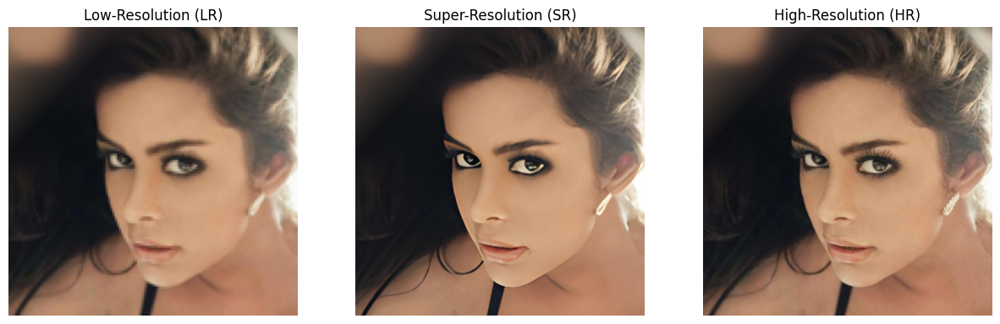

Processing: /content/drive/MyDrive/testing/24205.jpg


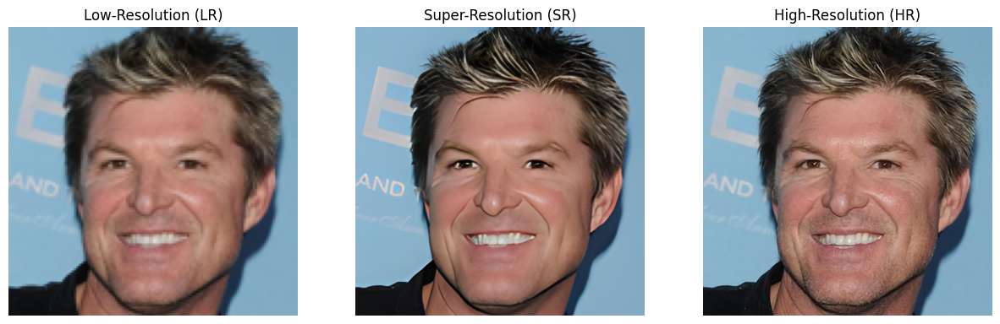

Processing: /content/drive/MyDrive/testing/24131.jpg


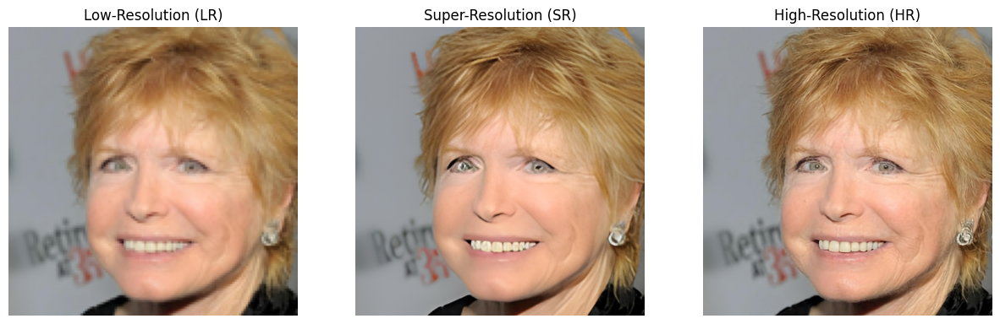

Processing: /content/drive/MyDrive/testing/24202.jpg


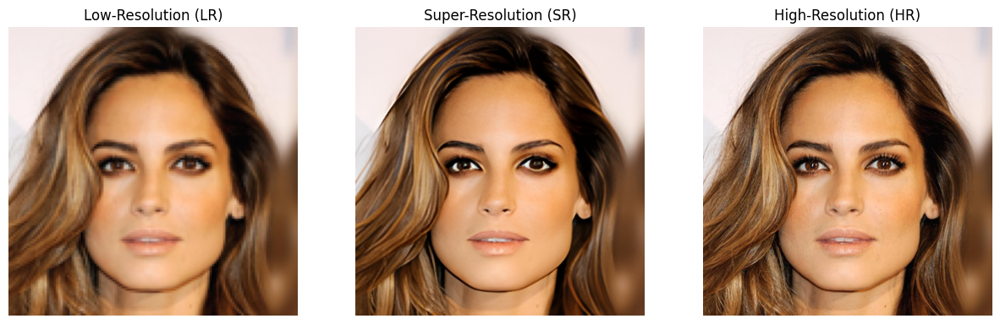

Processing: /content/drive/MyDrive/testing/24182.jpg


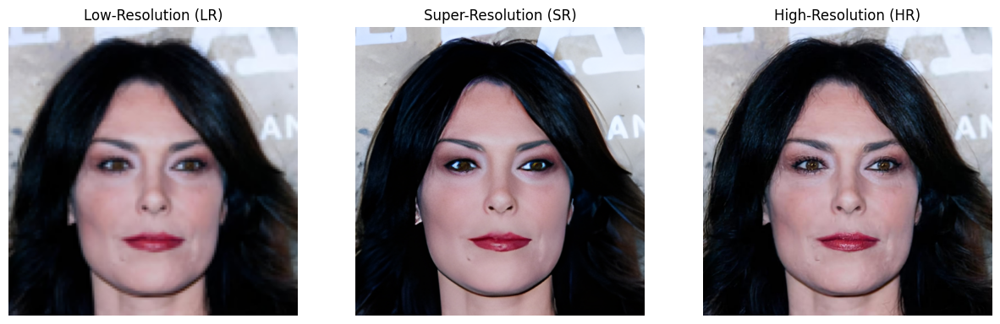

Processing: /content/drive/MyDrive/testing/24132.jpg


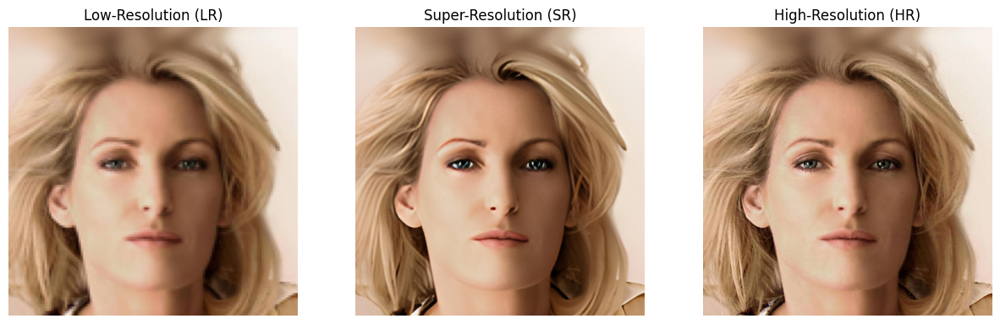

Processing: /content/drive/MyDrive/testing/24175.jpg


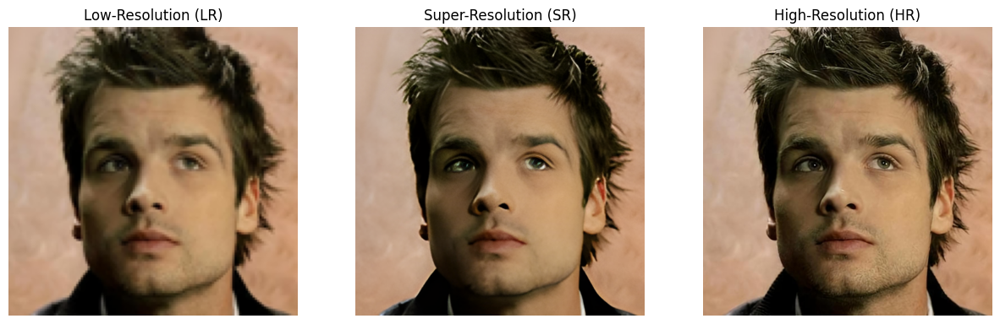

Processing: /content/drive/MyDrive/testing/24089.jpg


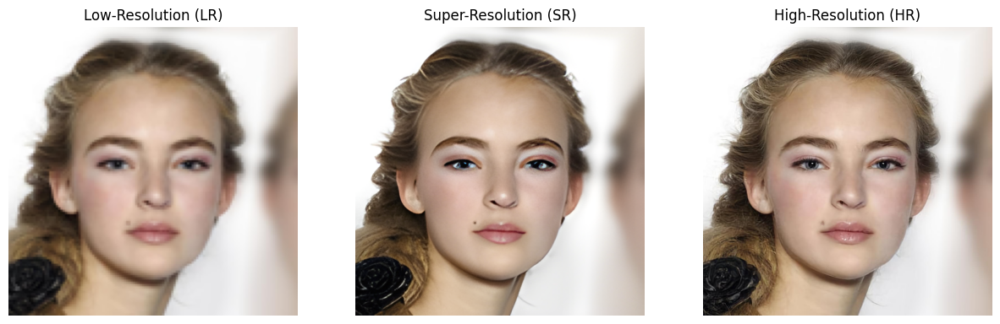

Processing: /content/drive/MyDrive/testing/24080.jpg


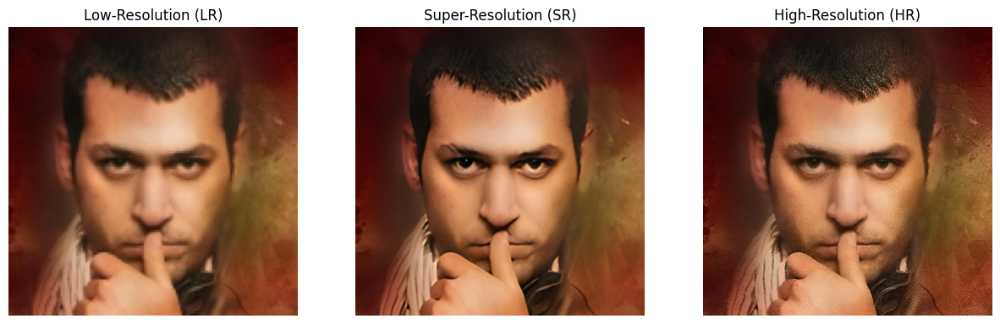

Processing: /content/drive/MyDrive/testing/24087.jpg


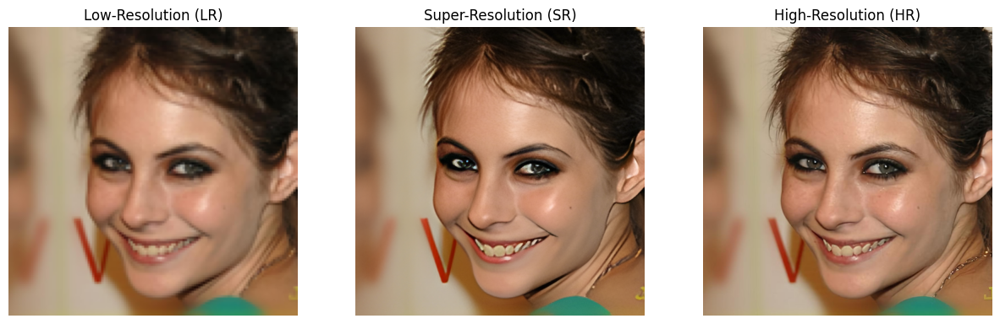

Super-resolution results saved to '/content/drive/MyDrive/testing_results'.


In [28]:
import os
import random
import torch
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from realesrgan import RealESRGANer
from torchvision.transforms.functional import to_tensor, to_pil_image
from basicsr.archs.rrdbnet_arch import RRDBNet
import numpy as np

# Paths
model_path = "/content/Real-ESRGAN/weights/lora_final.pth"
input_folder = "/content/drive/MyDrive/testing"
output_folder = "/content/drive/MyDrive/testing_results"
os.makedirs(output_folder, exist_ok=True)

# Step 1: Load Fine-Tuned Model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=23, num_grow_ch=32, scale=4).to(device)
model.load_state_dict(torch.load(model_path, map_location=device), strict=False)
model.eval()
print("Loaded fine-tuned model.")

# Initialize the upsampler
upsampler = RealESRGANer(
    scale=4,
    model_path=model_path,
    model=model,
    tile=0,
    tile_pad=10,
    pre_pad=0,
    half=True  # Use FP16 inference
)

# Step 2: Randomly Select 10 Images
all_images = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png'))]
random_images = random.sample(all_images, 10)
print(f"Randomly selected images: {random_images}")

# Step 3: Side-by-Side Comparison
def downsample_image(image, scale_factor=8):
    """Simulate a low-resolution image using bicubic downsampling."""
    return image.resize((image.width // scale_factor, image.height // scale_factor), Image.BICUBIC)

for idx, img_name in enumerate(random_images):
    img_path = os.path.join(input_folder, img_name)
    print(f"Processing: {img_path}")

    # Load High-Resolution (HR) image
    hr_image = Image.open(img_path).convert("RGB")

    # Simulate Low-Resolution (LR) image
    lr_image = downsample_image(hr_image, scale_factor=8)
    lr_array = cv2.cvtColor(np.array(lr_image), cv2.COLOR_RGB2BGR)

    # Perform Super-Resolution (SR) inference
    try:
        sr_array, _ = upsampler.enhance(lr_array, outscale=4)
        sr_image = Image.fromarray(cv2.cvtColor(sr_array, cv2.COLOR_BGR2RGB))
    except RuntimeError as error:
        print(f"Error processing {img_path}: {error}")
        continue

    # Save SR image
    sr_save_path = os.path.join(output_folder, f"{os.path.splitext(img_name)[0]}_output.png")
    sr_image.save(sr_save_path)

    # Step 4: Display Side-by-Side Comparison
    plt.figure(figsize=(15, 5))

    # Low-Resolution Image
    plt.subplot(1, 3, 1)
    plt.title("Low-Resolution (LR)")
    plt.imshow(lr_image)
    plt.axis("off")

    # Super-Resolution Image
    plt.subplot(1, 3, 2)
    plt.title("Super-Resolution (SR)")
    plt.imshow(sr_image)
    plt.axis("off")

    # High-Resolution Image
    plt.subplot(1, 3, 3)
    plt.title("High-Resolution (HR)")
    plt.imshow(hr_image)
    plt.axis("off")

    plt.show()

print(f"Super-resolution results saved to '{output_folder}'.")
